In [ ]:
# Dependencies  https://mindee.github.io/doctr/getting_started/installing.html
# https://github.com/tschoonj/GTK-for-Windows-Runtime-Environment-Installer/releases

## db_mobilenet_v3_large (4.2 M params) +
## crnn_mobilenet_v3_large (4.5M params)

In [ ]:
%matplotlib inline
import os

# os.environ['USE_TF'] = '1'
os.environ['USE_TORCH'] = '1'

import matplotlib.pyplot as plt
from doctr.io import DocumentFile

In [ ]:
from doctr.models import ocr_predictor
model = ocr_predictor('db_mobilenet_v3_large', 'crnn_mobilenet_v3_large', 
                      pretrained=True, assume_straight_pages=True, 
                      preserve_aspect_ratio=True)

In [ ]:
doc = DocumentFile.from_pdf("publaynet\PMC514606_00001.pdf")
print(f"Number of pages: {len(doc)}")

Number of pages: 50


In [ ]:
# Predict and check how much time it takes (for 50 pages)
import time
start_time = time.time()
result = model(doc)
print("--- %s seconds ---" % (time.time() - start_time))

--- 513.7876486778259 seconds ---


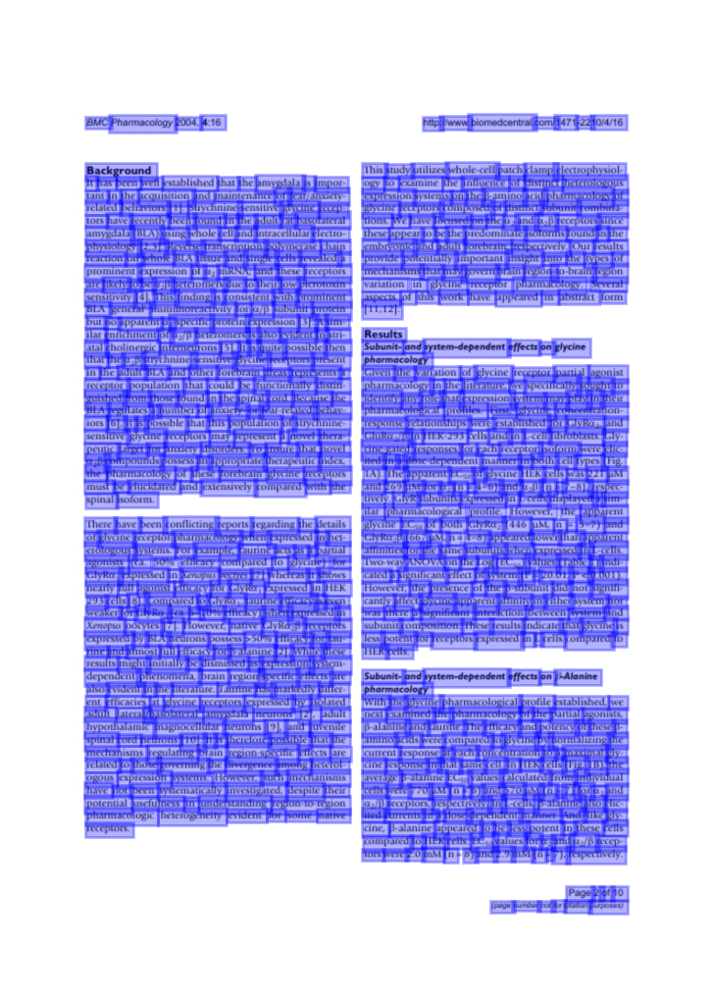

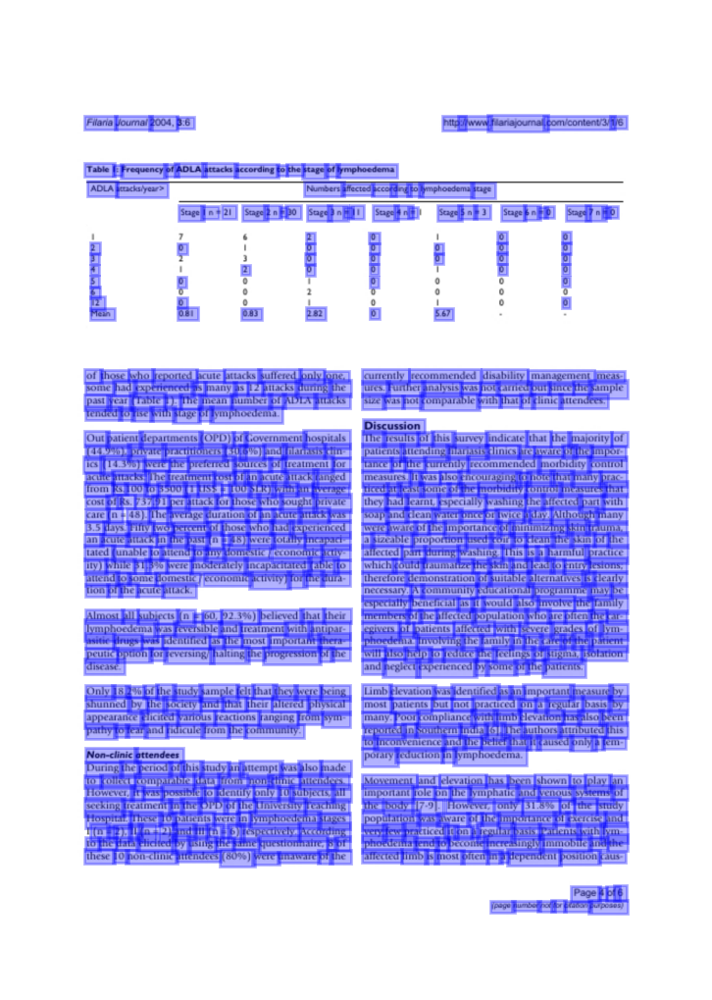

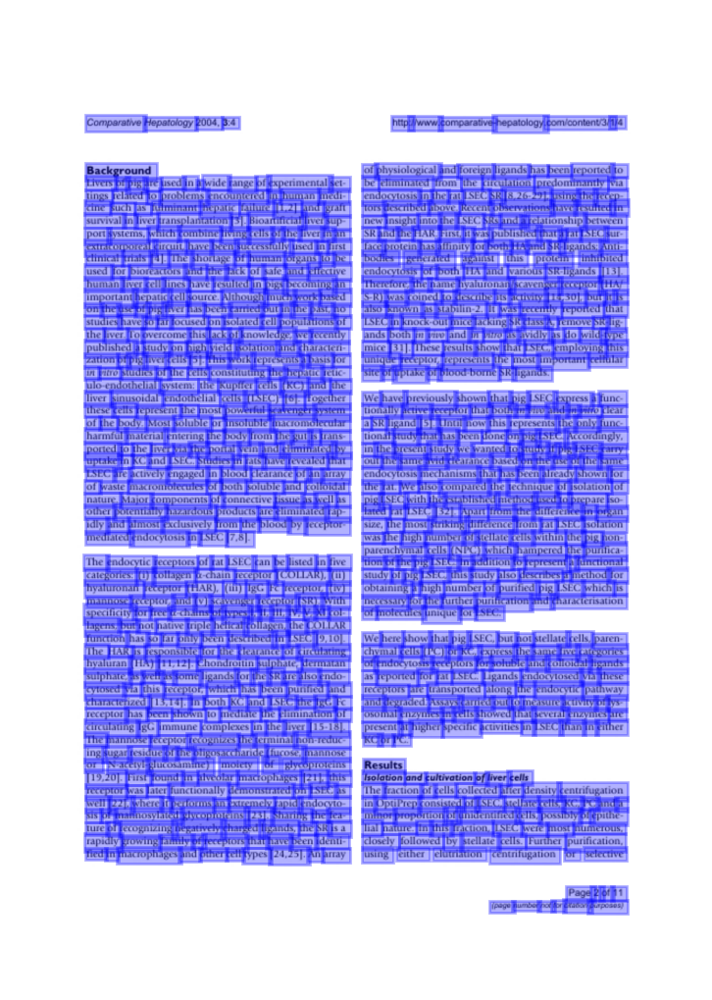

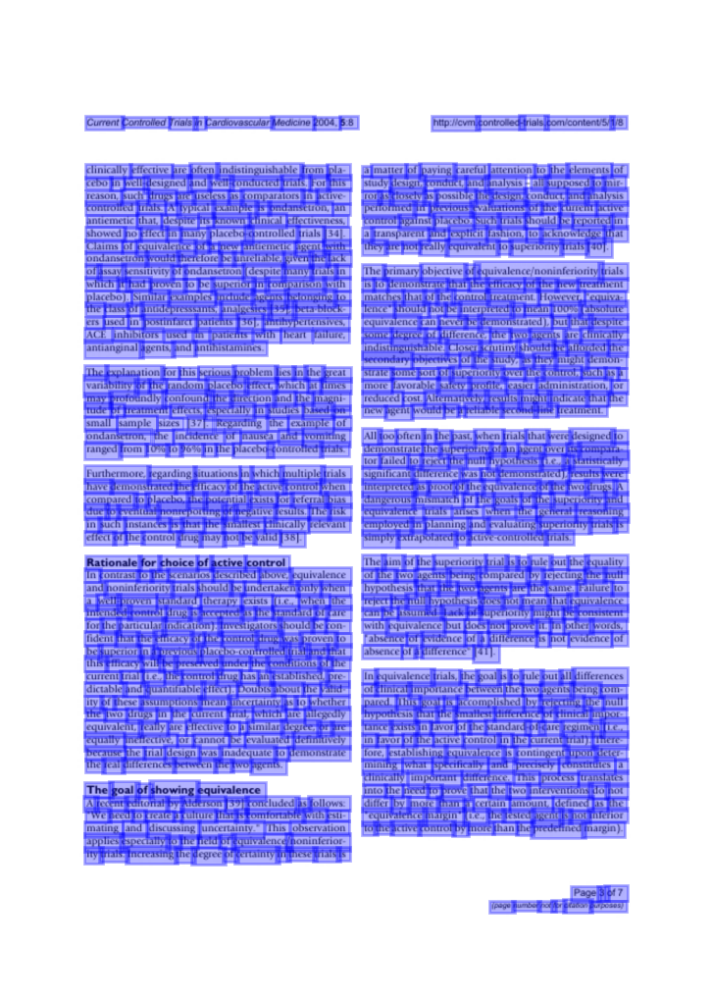

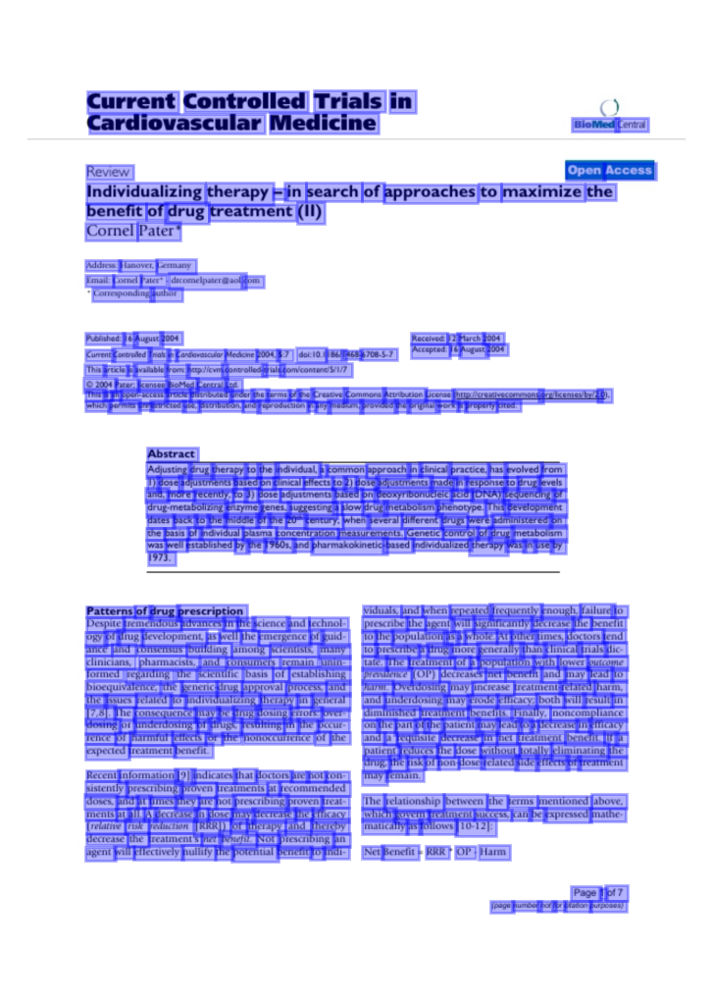

...

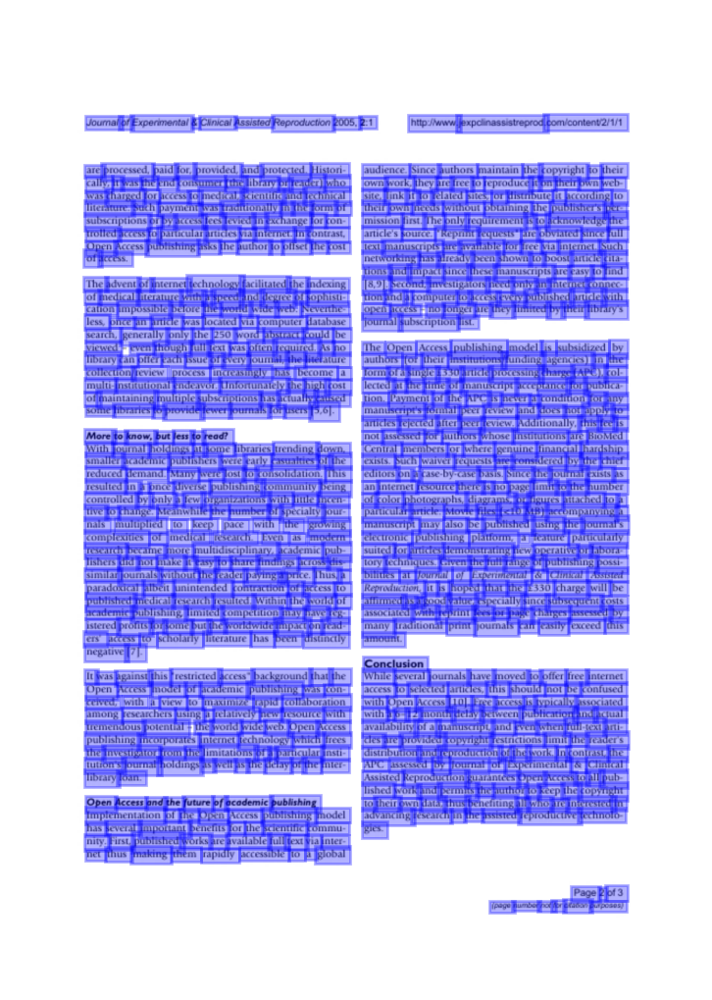

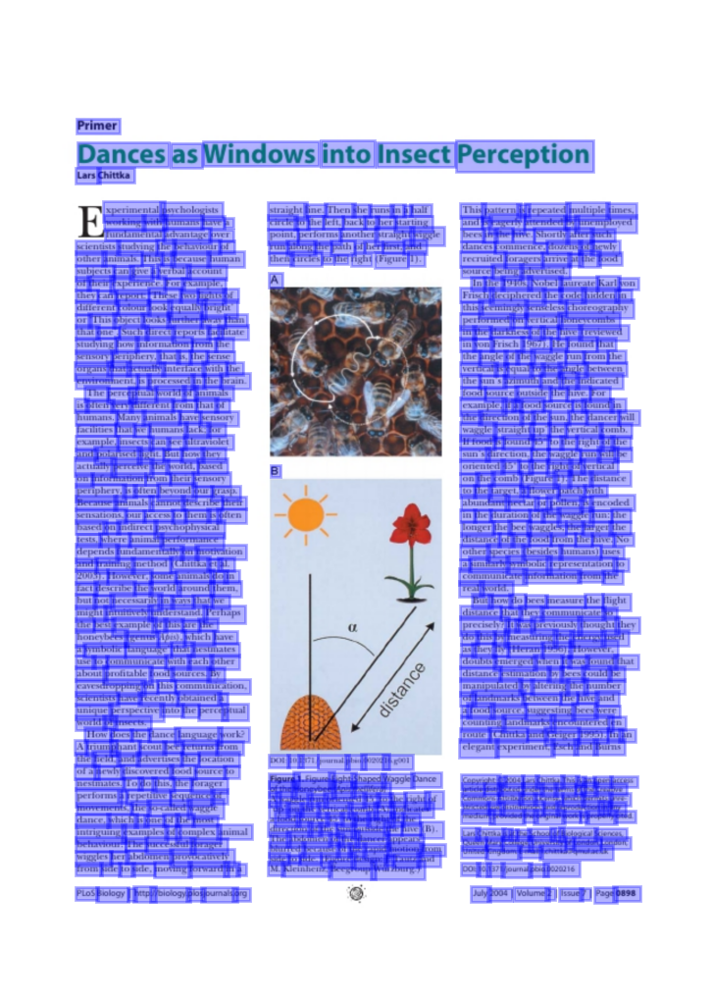

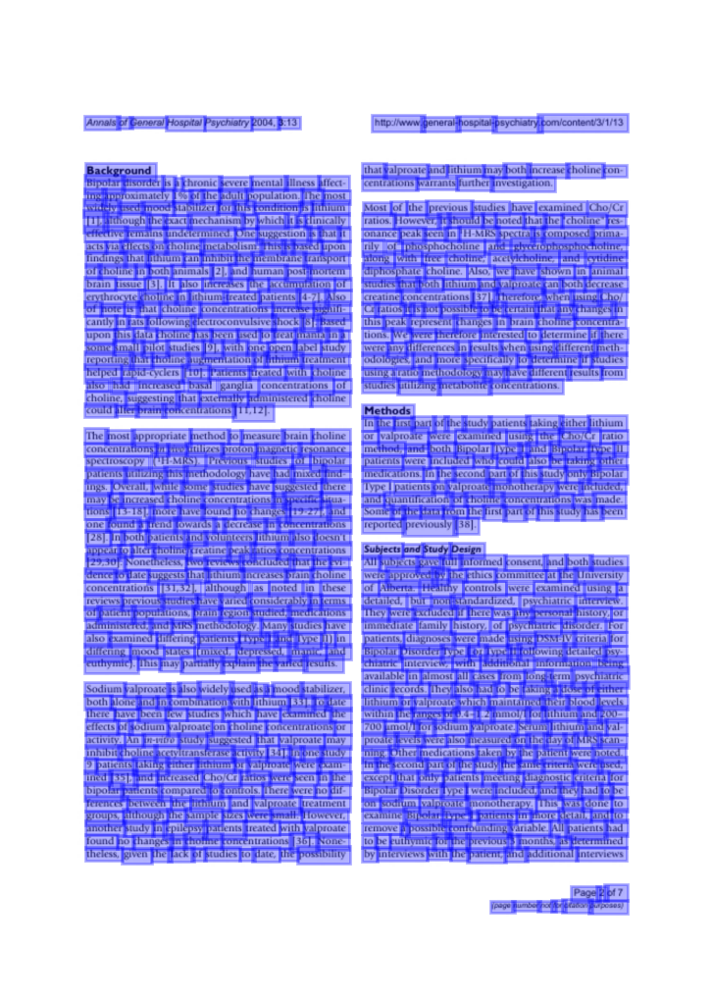

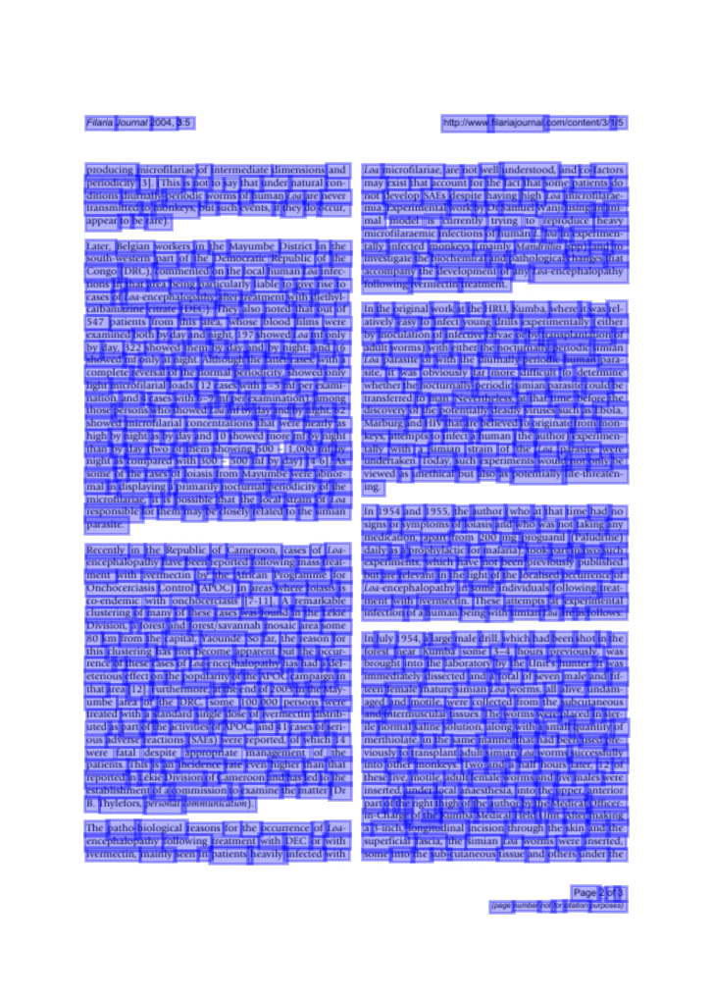

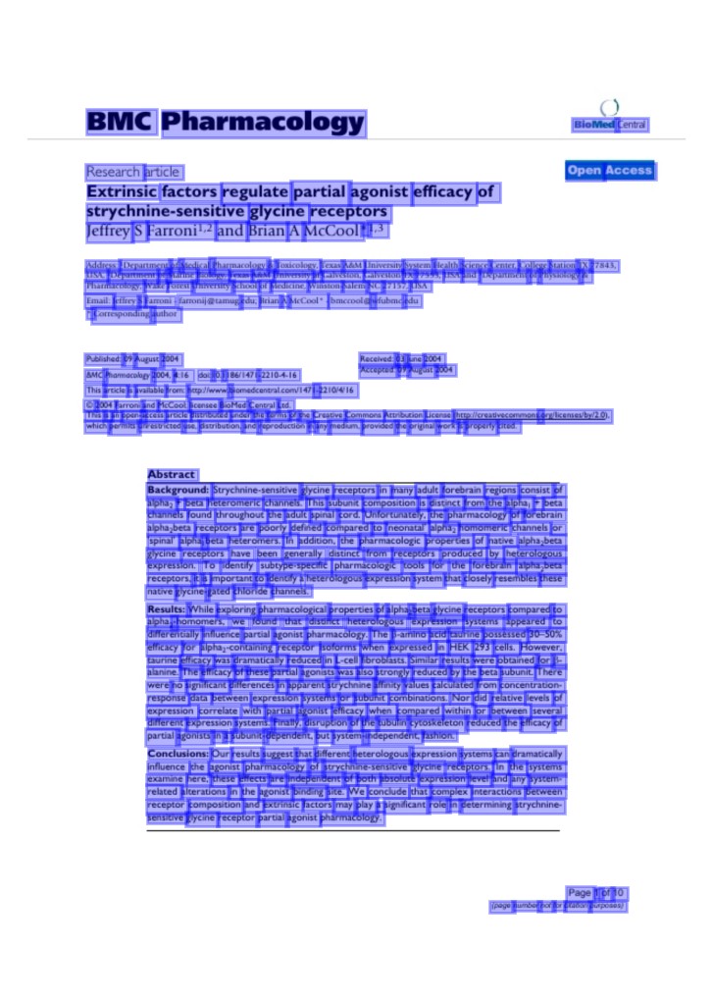

In [ ]:
result.show(doc)

In [ ]:
output = result.export()
output

{'pages': [{'page_idx': 0,
   'dimensions': (1684, 1190),
   'orientation': {'value': None, 'confidence': None},
   'language': {'value': None, 'confidence': None},
   'blocks': [{'geometry': ((0.10890559348739498, 0.107421875),
      (0.310671612394958, 0.1748046875)),
     'lines': [{'geometry': ((0.10890559348739498, 0.107421875),
        (0.310671612394958, 0.1259765625)),
       'words': [{'value': 'BMC',
         'confidence': 0.9903980493545532,
         'geometry': ((0.10890559348739498, 0.109375),
          (0.14621848739495796, 0.1220703125))},
        {'value': 'Pharmacology:',
         'confidence': 0.5442091226577759,
         'geometry': ((0.14207261029411766, 0.107421875),
          (0.24019170168067228, 0.1259765625))},
        {'value': '2004,',
         'confidence': 0.9988756775856018,
         'geometry': ((0.23742778361344535, 0.109375),
          (0.27750459558823526, 0.123046875))},
        {'value': '4:16',
         'confidence': 0.9988924860954285,
         'ge

## json comprehension

In [ ]:
for obj1 in output['pages'][0]["blocks"]:
    for obj2 in obj1["lines"]:
        for obj3 in obj2["words"]:
            print("{}: {}".format(obj3["geometry"],obj3["value"]))

((0.10890559348739498, 0.109375), (0.14621848739495796, 0.1220703125)): BMC
((0.14207261029411766, 0.107421875), (0.24019170168067228, 0.1259765625)): Pharmacology:
((0.23742778361344535, 0.109375), (0.27750459558823526, 0.123046875)): 2004,
((0.2747406775210084, 0.107421875), (0.310671612394958, 0.123046875)): 4:16
((0.10890559348739498, 0.15625), (0.2111705619747899, 0.1748046875)): Background
((0.5953551733193277, 0.109375), (0.6257582720588235, 0.1240234375)): http:
((0.6188484768907563, 0.1083984375), (0.6658350840336135, 0.123046875)): clwww.
((0.6603072478991596, 0.1064453125), (0.7598082983193277, 0.1240234375)): .biomedcentrald
((0.754280462184874, 0.109375), (0.791593356092437, 0.1220703125)): com/1
((0.7846835609243697, 0.107421875), (0.8192325367647059, 0.123046875)): 1471
((0.816468618697479, 0.1083984375), (0.8427258403361344, 0.1220703125)): -221
((0.8371980042016807, 0.107421875), (0.8897124474789916, 0.123046875)): 10/4/16
((0.5069097951680672, 0.15625), (0.54422268907